# Exploration des données : 

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle

In [35]:
df = pickle.load(open('df_final.p','rb'))

## Pré traitement des données :

In [36]:
df.reset_index(inplace=True)
df['id'] = df.index
list_columns = ['id' ]+ list(df.columns[:-1])
df = df[list_columns].reset_index()

In [84]:
df_functions = df[['id','functions']]
df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)
df_functions =df_functions.explode('functions').reset_index(drop=True)

C:\Users\axelp\AppData\Local\Temp\ipykernel_9908\1132624101.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)


In [70]:
## compute the data set with basic information about the entities
columns_kept = [col for col in list(df.columns) if col not in ['objectives','offers','activities','member_statuses','hash','url_suffix','functions']]
df_information = df[columns_kept]
df_information = df_information.join(pd.json_normalize( df_information['communication'])).drop('communication', axis=1)
df_information = df_information.join(pd.json_normalize( df_information['contact'])).drop('contact', axis=1)

In [ ]:
df_information

,index,id,file_name,name,status,localisation,functions,url_suffix,description,url,website_type,association_name,member_statuses,contact,text_name,facebook_follower,facebook_likes,instagram_followers,instagram_publication
0,0,0,Les_Éphémères,Les Éphémères,Association,Mers-les-Bains,"Prod live : Festival, Prod live : Organisateur",ctct-info.php?s=938,"Depuis 2017, Les Éphémères ont rassemblé des c...",https://lesephemeres.org/,Site personnel,Les Éphémères,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@lesephemeres.fr'},Les_Éphémères,NaN,NaN,NaN,NaN
1,1,1,Make_My_Day,Make My Day,Association,Amiens,"Collectif d'artistes, Prod live : Organisateur...",ctct-info.php?s=937,"Soutenir, promouvoir et développer les musique...",mailto:assomakemyday@gmail.com,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2,Le_Bureau_des_Spectacles,Le Bureau des Spectacles,SAS,Lille,Prod live : Organisateur,ctct-info.php?s=936,"Le Bureau des Spectacle imagine, organise et p...",https://www.lebureaudesspectacles.fr,Site personnel,Le Bureau des Spectacles,"[{'description': 'Membre actif', 'price': None...",{'email': 'billetterie@lebureaudesspectacles.fr'},Le_Bureau_des_Spectacles,NaN,NaN,NaN,NaN
3,3,3,Billy_Society_Production,Billy Society Production,,Lille,Prod live : Organisateur,ctct-info.php?s=932,Billy Society Production s'inscrit dans la lig...,https://www.facebook.com/billysociety.prod,Facebook,Billy Society Production,"[{'description': 'Membre actif', 'price': None...",{'email': 'billysocietyprod@gmail.com'},Billy_Society_Production,95.0,76.0,NaN,NaN
4,4,4,Ginger_Kick_Events,Ginger Kick Events,Association,La Madeleine,Prod live : Organisateur,ctct-info.php?s=926,"Organisation de concerts rock, principalement ...",https://linktr.ee/gingerkick,Site personnel,Ginger Kick Events,"[{'description': 'Membre actif', 'price': 20, ...",{'email': 'contact@gingerkickevents.com'},Ginger_Kick_Events,150.0,100.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
164,164,164,Rock_Aisne_festival,Rock Aisne festival,Association,Villequier-Aumont,"Prod live : Organisateur, Prod live : Festival",ctct-info.php?s=155,Le festival se déroule au CENTRE CULTUREL DE C...,https://www.rockaisne.com,Site personnel,Rock Aisne Festival,"[{'description': 'VIP', 'price': 70, 'status':...",{'email': 'jeanmichelfondement@gmail.com'},Rock_Aisne_festival,1000.0,2500.0,NaN,15.0
165,165,165,Reivax_Tour,Reivax Tour,Association,La Fère,"Prod live : Organisateur, Prod live : Tour et ...",ctct-info.php?s=566,Reivax Tour (écrit aussi Reivaks Tour) est une...,https://reivaxtour.mystrikingly.com,Site personnel,Association des Amis de la Nature,[{'description': 'Membre actif participant rég...,{'email': 'contact@amisnature.com'},Reivax_Tour,1500.0,2000.0,1200.0,NaN
166,166,166,Saint-Omer_Jaaz_festival,Saint-Omer Jaaz festival,EPCC,Saint-Omer,"Prod live : Organisateur, Prod live : Festival...",ctct-info.php?s=182,Fort de 25 concerts gratuits présentés dans de...,http://www.saintomerjaazfestival.fr,Site personnel,Association Jaaz Festival,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@jaazfestival.fr'},Saint-Omer_Jaaz_festival,1500.0,1200.0,800.0,50.0
167,167,167,Rock_en_Stock,Rock en Stock,Association,Etaples sur Mer,"Prod live : Organisateur, Prod live : Festival",ctct-info.php?s=184,,https://www.rockenstock.fr,Site personnel,Association Rock en Stock Opale,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@rockenstock.fr'},Rock_en_Stock,NaN,NaN,NaN,NaN


In [161]:
i=101
print(df.loc[i,'association_name'])
print(df.loc[i,'offers'])
print(df.loc[i,'activities'])
print(df.loc[i,'objectives'])

Association des Amis de la Nature
[{'description': 'Réduction sur les ateliers de cuisine pour les membres actifs', 'name': 'Réduction Atelier Cuisine', 'price': 20, 'target_group': 'Membres actifs'}, {'description': 'Sortie randonnée gratuite pour les nouveaux membres', 'name': 'Randonnée Gratuite', 'price': None, 'target_group': 'Nouveaux membres'}]
[{'name': 'Atelier de cuisine', 'price': 25}, {'name': 'Sortie randonnée', 'price': None}]
["Promouvoir la protection de l'environnement", 'Organiser des activités de plein air', "Sensibiliser le public à l'écologie"]


In [162]:
df.columns ##.drop_columns(['objectives, activities','offers','member_statuses'])

Index(['index', 'id', 'file_name', 'name', 'status', 'localisation',
       'functions', 'url_suffix', 'description', 'url', 'website_type',
       'association_name', 'objectives', 'activities', 'offers',
       'member_statuses', 'contact', 'communication', 'hash', 'text_name'],
      dtype='object')

In [88]:
## Create dataframe for objectives,activities, functions, offers, member_statuses
##-------------------------------------------------------------------------------


df_objectives = df[['id','objectives']].explode('objectives')
df_activities = df[['id','activities']].explode('activities')
df_offers = df[['id','offers']].explode('offers')
df_members = df[['id','member_statuses']].explode('member_statuses')

df_offers = df_offers.join(pd.json_normalize(df_offers['offers'] , sep = '_')).drop('offers',axis=1)
df_activities = df_activities.join( pd.json_normalize(df_activities['activities']) ).drop('activities',axis=1)
df_members = df_members.join( pd.json_normalize(df_members['member_statuses']) ).drop('member_statuses',axis=1)

## Create the functions dataframe.
df_functions = df[['id','functions']]
df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)
df_functions =df_functions.explode('functions').reset_index(drop=True)


C:\Users\axelp\AppData\Local\Temp\ipykernel_9908\1078076753.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_functions['functions'] = df_functions.apply(lambda r: r['functions'].split(sep=','),axis=1)


In [89]:
import pickle
pickle.dump(df_objectives,open('df_objectives.p','wb'))
pickle.dump(df_activities,open('df_activities.p','wb'))
pickle.dump(df_offers,open('df_offers.p','wb'))
pickle.dump(df_members,open('df_members.p','wb'))
pickle.dump(df_information,open('df_information.p','wb'))
pickle.dump(df_functions,open('df_functions.p','wb'))

## EDA

In [8]:
# Aperçu des données
display(df.head())
print("\nInformations générales :")
df.info()
print("\nStatistiques descriptives :")
display(df.describe())

,name,status,localisation,functions,url_suffix,description,url,website_type,association_name,objectives,activities,offers,member_statuses,contact,communication,hash,text_name
file_name,,,,,,,,,,,,,,,,,
Les_Éphémères,Les Éphémères,Association,Mers-les-Bains,"Prod live : Festival, Prod live : Organisateur",ctct-info.php?s=938,"Depuis 2017, Les Éphémères ont rassemblé des c...",https://lesephemeres.org/,Site personnel,Les Éphémères,"[Développer la culture dans le secteur rural, ...","[{'name': 'Le Cabaret des Bains', 'price': Non...",[{'description': 'Soirées animées par des DJ o...,"[{'description': 'Membre actif', 'price': None...",{'email': 'contact@lesephemeres.fr'},"{'facebook_follower': None, 'facebook_likes': ...",2b218b551229ea5b23dbfcc6a5da765be073d60df7f822...,Les_Éphémères
Make_My_Day,Make My Day,Association,Amiens,"Collectif d'artistes, Prod live : Organisateur...",ctct-info.php?s=937,"Soutenir, promouvoir et développer les musique...",mailto:assomakemyday@gmail.com,None,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Le_Bureau_des_Spectacles,Le Bureau des Spectacles,SAS,Lille,Prod live : Organisateur,ctct-info.php?s=936,"Le Bureau des Spectacle imagine, organise et p...",https://www.lebureaudesspectacles.fr,Site personnel,Le Bureau des Spectacles,[Produire des spectacles dans les Hauts-de-Fra...,"[{'name': 'Concert de Roch Voisine', 'price': ...",[{'description': 'Offre spéciale pour les grou...,"[{'description': 'Membre actif', 'price': None...",{'email': 'billetterie@lebureaudesspectacles.fr'},"{'facebook_follower': None, 'facebook_likes': ...",f9bce16a338c760c4a4fc34137278039535131bf208059...,Le_Bureau_des_Spectacles
Billy_Society_Production,Billy Society Production,,Lille,Prod live : Organisateur,ctct-info.php?s=932,Billy Society Production s'inscrit dans la lig...,https://www.facebook.com/billysociety.prod,Facebook,Billy Society Production,"[Promouvoir la culture musicale, Organiser des...",[{'name': 'Concert de Dimimagery et Nakedsoftm...,[{'description': 'Concert de groupes émergents...,"[{'description': 'Membre actif', 'price': None...",{'email': 'billysocietyprod@gmail.com'},"{'facebook_follower': 95, 'facebook_likes': 76...",ef2c10d646af70e059a493f74e7f6f914a072c35cd074e...,Billy_Society_Production
Ginger_Kick_Events,Ginger Kick Events,Association,La Madeleine,Prod live : Organisateur,ctct-info.php?s=926,"Organisation de concerts rock, principalement ...",https://linktr.ee/gingerkick,Site personnel,Ginger Kick Events,"[Promouvoir les activités de plein air, Encour...","[{'name': 'Randonnée', 'price': None}, {'name'...","[{'description': 'Réduction pour les membres',...","[{'description': 'Membre actif', 'price': 20, ...",{'email': 'contact@gingerkickevents.com'},"{'facebook_follower': 150, 'facebook_likes': 1...",e3b0c44298fc1c149afbf4c8996fb92427ae41e4649b93...,Ginger_Kick_Events



Informations générales :
<class 'pandas.core.frame.DataFrame'>
Index: 169 entries, Les_Éphémères to Dynamo
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   name              169 non-null    object
 1   status            169 non-null    object
 2   localisation      169 non-null    object
 3   functions         169 non-null    object
 4   url_suffix        169 non-null    object
 5   description       169 non-null    object
 6   url               165 non-null    object
 7   website_type      158 non-null    object
 8   association_name  135 non-null    object
 9   objectives        135 non-null    object
 10  activities        135 non-null    object
 11  offers            135 non-null    object
 12  member_statuses   135 non-null    object
 13  contact           135 non-null    object
 14  communication     135 non-null    object
 15  hash              135 non-null    object
 16  text_name         135 non-

,name,status,localisation,functions,url_suffix,description,url,website_type,association_name,objectives,activities,offers,member_statuses,contact,communication,hash,text_name
count,169,169,169,169,169,169,165,158,135,135,135,135,135,135,135,135,135
unique,169,8,64,50,169,145,165,3,131,134,135,126,79,132,77,104,135
top,Les Éphémères,Association,Lille,Prod live : Organisateur,ctct-info.php?s=938,,https://lesephemeres.org/,Site personnel,Association des Amis de la Nature,[],"[{'name': 'Le Cabaret des Bains', 'price': Non...",[],"[{'description': 'Membre actif', 'price': None...",{'email': 'lesmorueselectriques@gmail.com'},"{'facebook_follower': None, 'facebook_likes': ...",e3b0c44298fc1c149afbf4c8996fb92427ae41e4649b93...,Les_Éphémères
freq,1,97,60,60,1,25,1,86,3,2,1,10,22,2,46,32,1


In [ ]:
# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display( df.isnull().sum() )


Valeurs manquantes :


name                 0
status               0
localisation         0
functions            0
url_suffix           0
description          0
url                  4
website_type        11
association_name    34
objectives          34
activities          34
offers              34
member_statuses     34
contact             34
communication       34
hash                34
text_name           34
dtype: int64

In [13]:
df.reset_index(inplace=True)

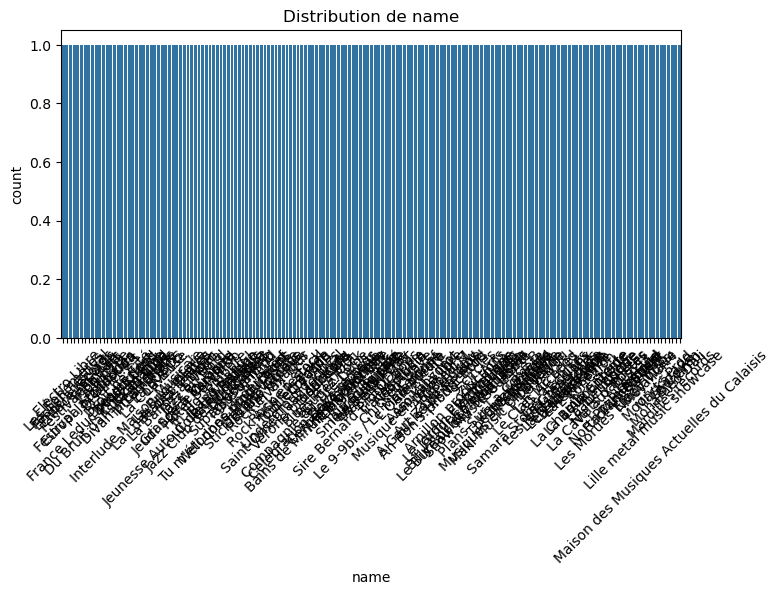

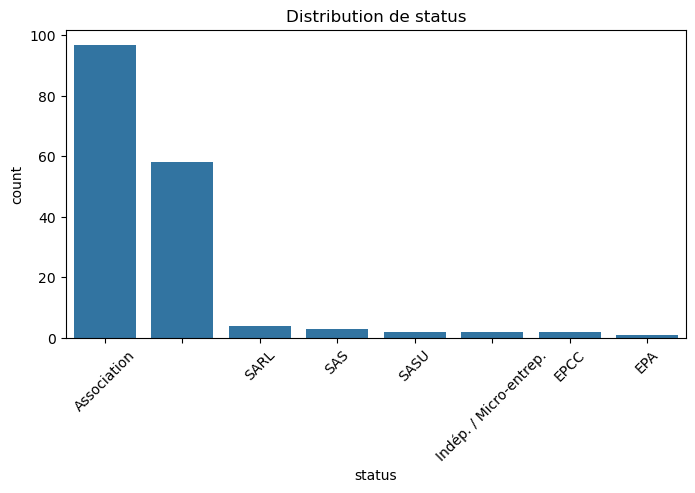

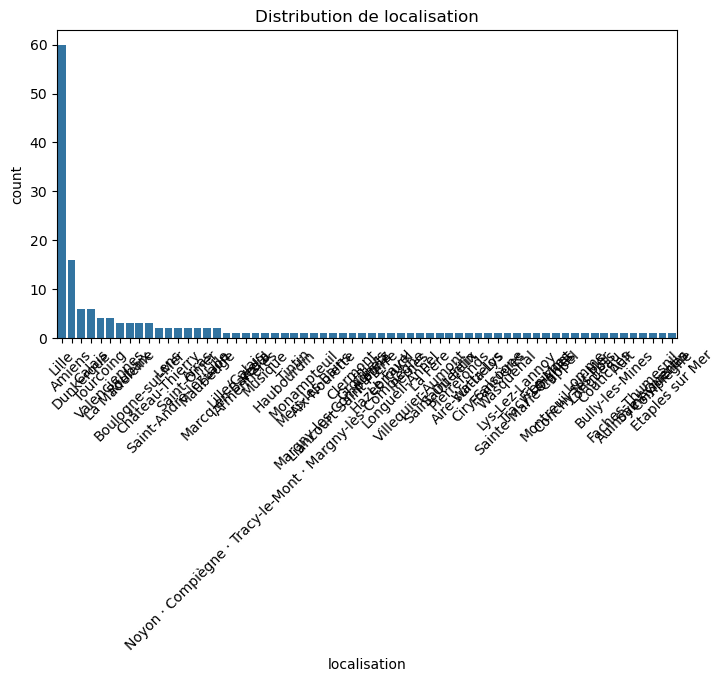

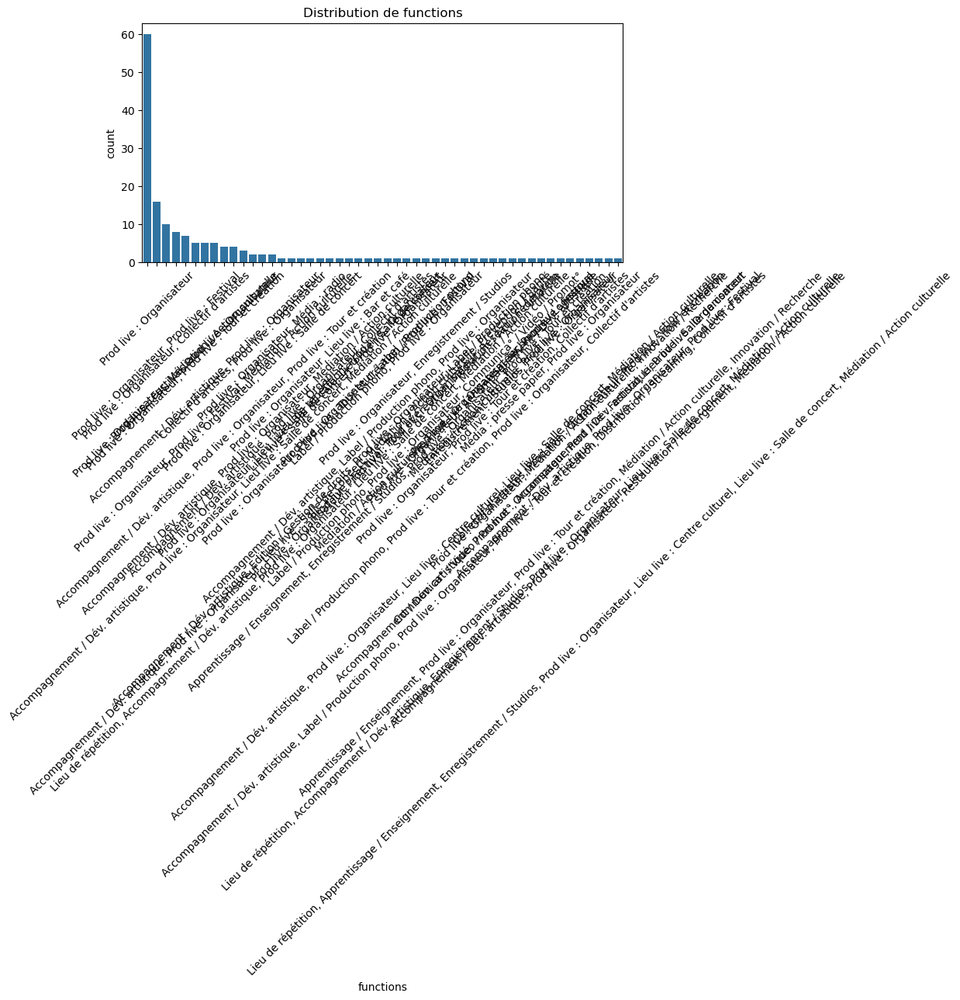

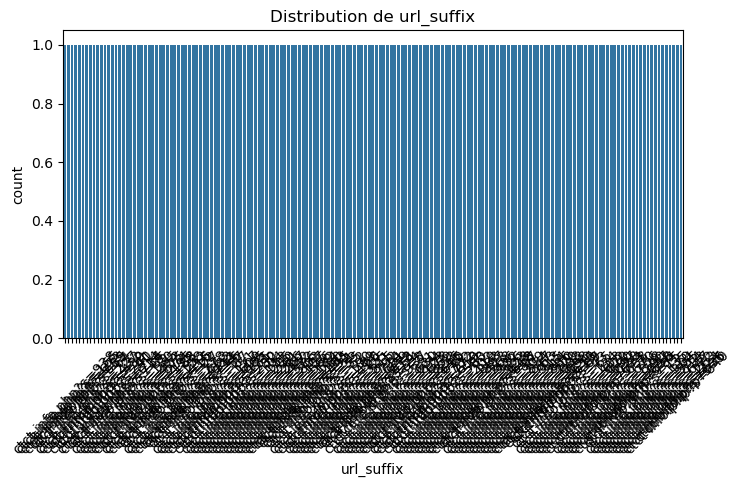

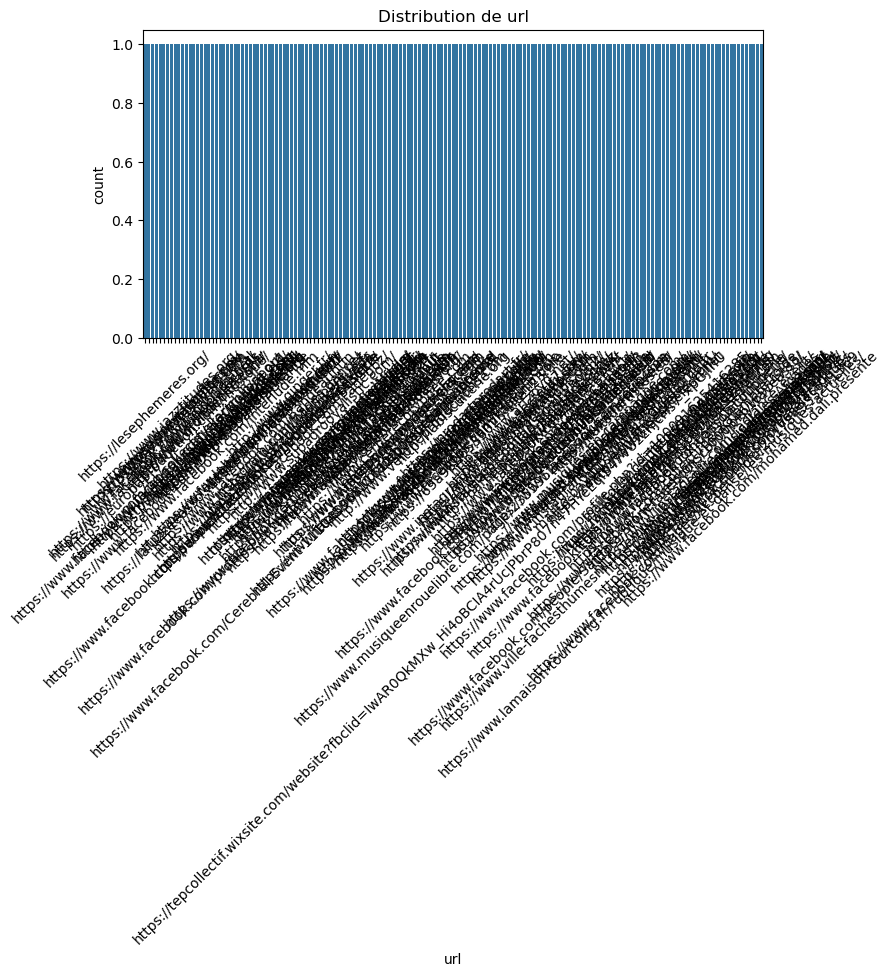

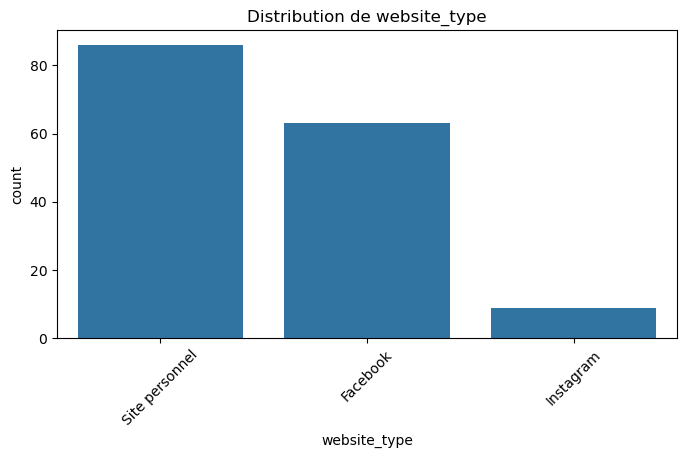

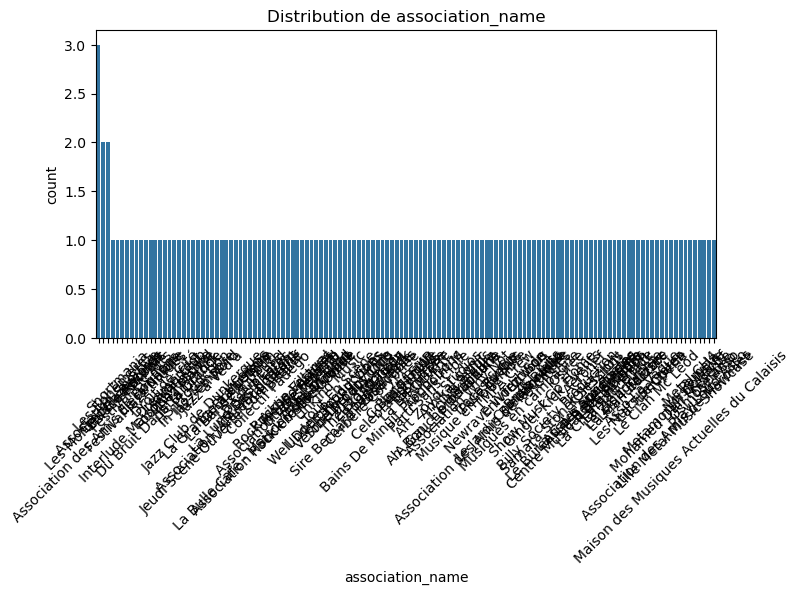

c:\Users\axelp\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 23494 (\N{CJK UNIFIED IDEOGRAPH-5BC6}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\axelp\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 27491 (\N{CJK UNIFIED IDEOGRAPH-6B63}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\axelp\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20184 (\N{CJK UNIFIED IDEOGRAPH-4ED8}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
c:\Users\axelp\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Glyph 20998 (\N{CJK UNIFIED IDEOGRAPH-5206}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


RuntimeError: In draw_glyphs_to_bitmap: Could not convert glyph to bitmap (raster overflow; error code 0x62)

<Figure size 800x400 with 1 Axes>

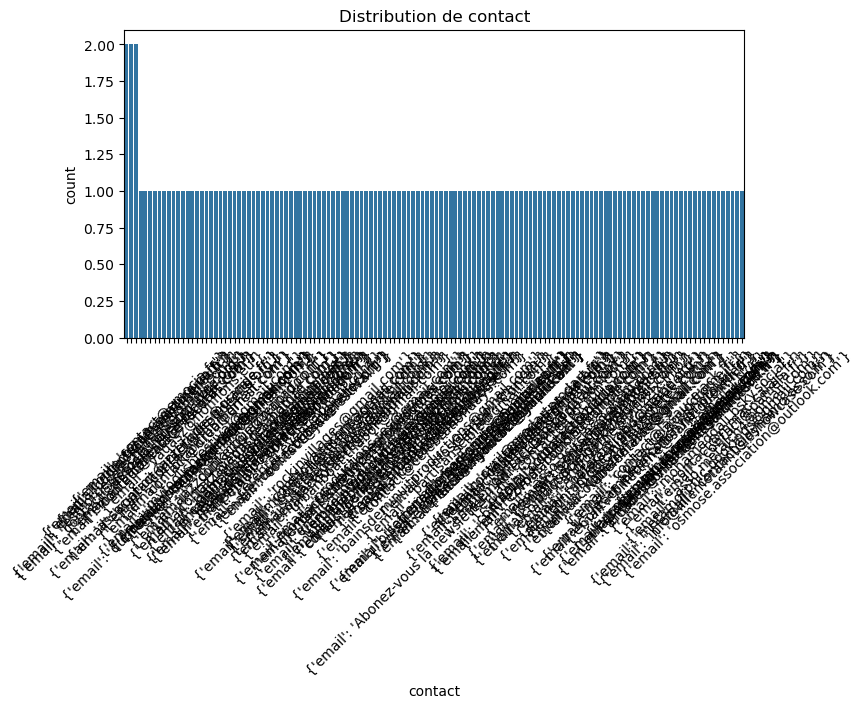

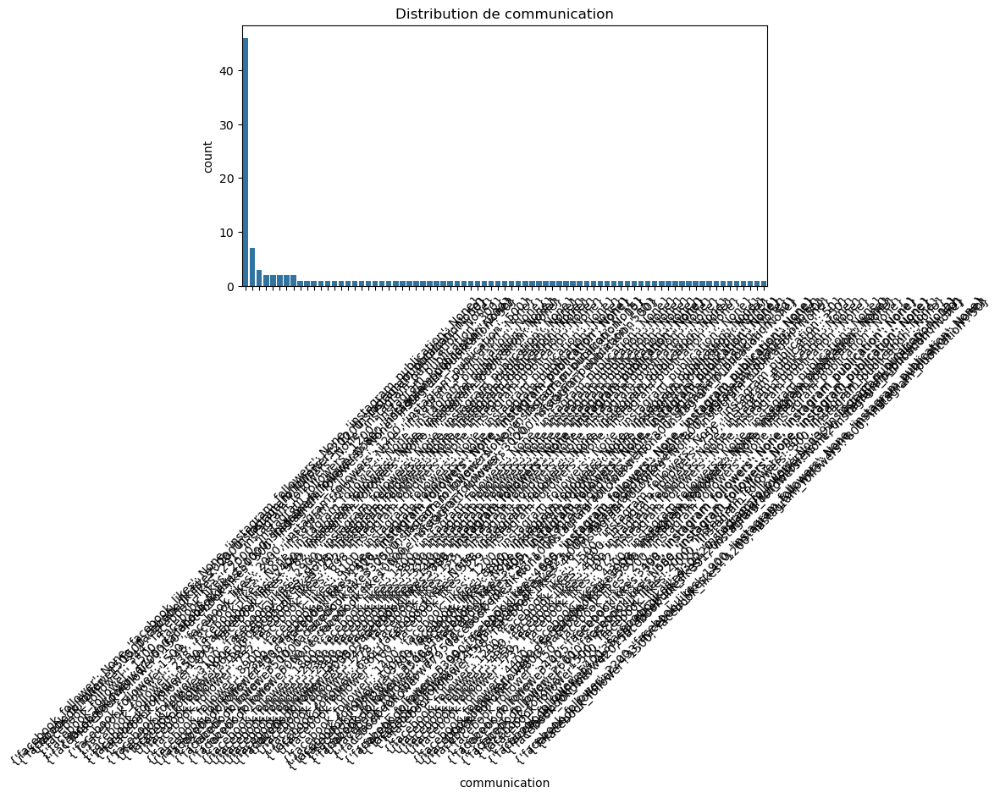

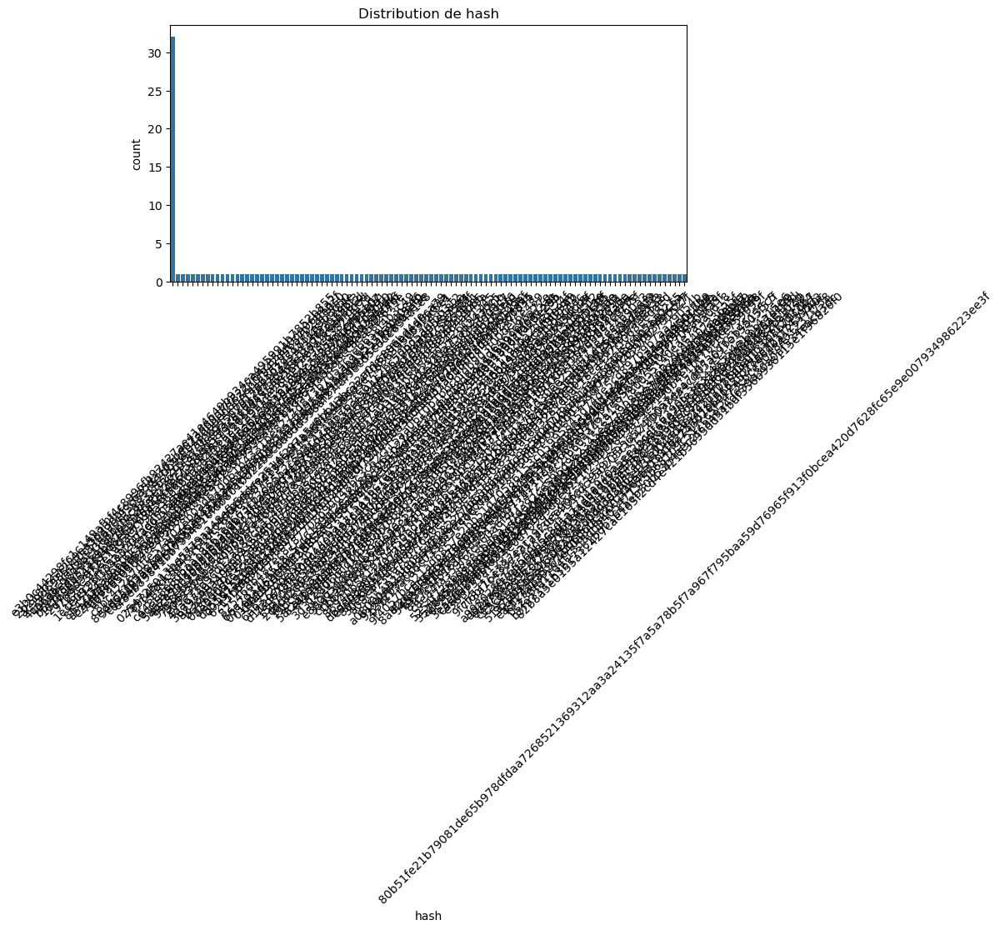

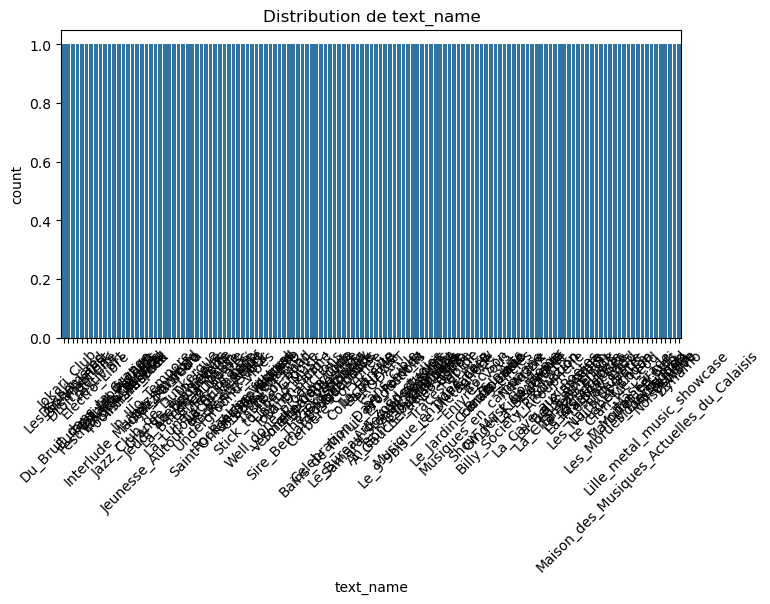

In [11]:
# Analyse des variables catégorielles
cat_cols = df.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df[col], order=df[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

In [18]:
df.columns

Index(['file_name', 'name', 'status', 'localisation', 'functions',
       'url_suffix', 'description', 'url', 'website_type', 'association_name',
       'objectives', 'activities', 'offers', 'member_statuses', 'contact',
       'communication', 'hash', 'text_name'],
      dtype='object')

In [21]:
i=35
print(df.loc[i,'association_name'])
print( df.loc[i,'offers'])
print(df.loc[i,'activities'])
print(df.loc[i,'objectives'])

Amikal Sonic
[{'description': "Amikal Sonic's saturday Confined Clubbing livestream", 'name': 'Confined Clubbing Livestream', 'price': None, 'target_group': 'Facebook users'}]
[{'name': 'Confined Clubbing Livestream', 'price': None}]
['Chaque semaine durant le COVID19 confinement', 'everyweek during the COVID19 lockdown', 'livre stream on facebook']


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Chargement des données
# Remplacez 'dataset.csv' par le nom de votre fichier
df = pd.read_csv('dataset.csv')

# Aperçu des données
display(df.head())
print("\nInformations générales :")
df.info()
print("\nStatistiques descriptives :")
display(df.describe())

# Vérification des valeurs manquantes
print("\nValeurs manquantes :")
display(df.isnull().sum())

# Vérification des doublons
print("\nDoublons :", df.duplicated().sum())

# Distribution des variables numériques
plt.figure(figsize=(12, 6))
df.hist(bins=30, figsize=(12, 10), layout=(5, 3))
plt.show()

# Analyse des variables catégorielles
cat_cols = df.select_dtypes(include=['object']).columns
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(x=df[col], order=df[col].value_counts().index)
    plt.xticks(rotation=45)
    plt.title(f"Distribution de {col}")
    plt.show()

# Analyse des relations entre variables (corrélation pour les numériques)
plt.figure(figsize=(10, 6))
sns.heatmap(df.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Matrice de Corrélation")
plt.show()

# Détection des valeurs aberrantes
num_cols = df.select_dtypes(include=['number']).columns
for col in num_cols:
    plt.figure(figsize=(8, 4))
    sns.boxplot(x=df[col])
    plt.title(f"Boxplot de {col}")
    plt.show()

# Sauvegarde du dataset nettoyé (après modifications éventuelles)
df.to_csv('cleaned_data.csv', index=False)
print("\nDataset nettoyé sauvegardé sous 'cleaned_data.csv'")